In [ ]:
---
title: "기말고사 예상문제"
author: "전현지"
format: dashboard
execute: 
  enabled: true
  cache: false
  freeze: false
  error: true
---

In [22]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.io as pio
import json
import requests
import pickle

#--#
import folium

pd.options.plotting.backend = "plotly"
pio.templates.default = "plotly_white"



# 1. NYCTaxi 자료 분석 (dashboard) -- 100점

In [23]:
### 데이터 정리

In [24]:

df = pd.read_csv("https://raw.githubusercontent.com/guebin/DV2023/main/posts/NYCTaxi.csv").assign(
    log_trip_duration = lambda df: np.log(df.trip_duration),
    pickup_datetime = lambda df: df.pickup_datetime.apply(pd.to_datetime),
    dropoff_datetime = lambda df: df.dropoff_datetime.apply(pd.to_datetime),
    dist = lambda df: np.sqrt((df.pickup_latitude-df.dropoff_latitude)**2 + (df.pickup_longitude-df.dropoff_longitude)**2),
    #---#
    vendor_id = lambda df: df.vendor_id.map({1:'A',2:'B'})
).assign(
    speed = lambda df: df.dist / df.trip_duration,
    pickup_hour = lambda df: df.pickup_datetime.dt.hour,
    dropoff_hour = lambda df: df.dropoff_datetime.dt.hour,
    dayofweek = lambda df: df.pickup_datetime.dt.dayofweek
)
df_small = df[::100].reset_index(drop=True)

# 요일 정리 dct
dct = {0:'월',1:'화',2:'수',3:'목',4:'금',5:'토',6:'일'}

# tidydata
tidydata = df.pivot_table(
    index = 'pickup_hour',
    columns = 'dayofweek',
    values = 'speed',
    aggfunc = 'mean'
).stack().reset_index().rename({0:'speed'}, axis = 1).sort_values('dayofweek').assign(dayofweek = lambda df : df.dayofweek.map(dct))
tidydata

,pickup_hour,dayofweek,speed
0,0,월,0.000062
112,16,월,0.000036
28,4,월,0.000075
105,15,월,0.000034
161,23,월,0.000058
...,...,...,...
118,16,일,0.000037
125,17,일,0.000043
132,18,일,0.000040
69,9,일,0.000046


## `(1)` 요일,시간에 따른 평균속력 시각화 -- 25점

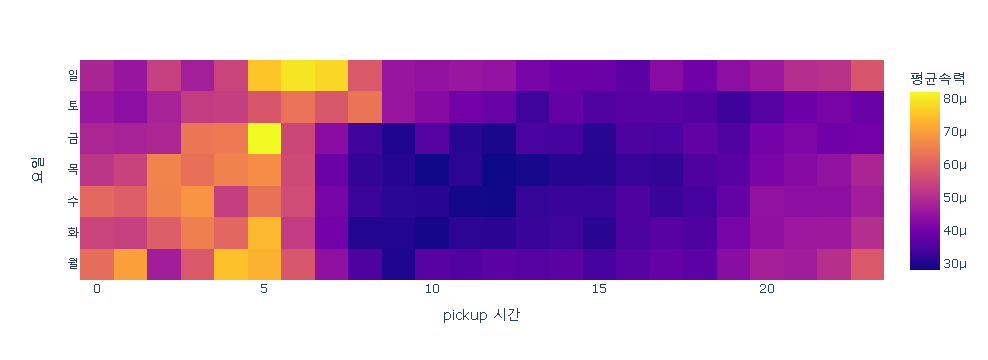

In [25]:
fig = px.density_heatmap(
    data_frame = tidydata,
    x = 'pickup_hour',
    y = 'dayofweek',
    z = 'speed',
    nbinsx=24,
    nbinsy=7,
    height=300

)
fig.data[0]['hovertemplate'] = 'pickup_hour=%{x}<br>dayofweek=%{y}<br>sum of speed_mean=%{z}<extra></extra>'

layout = {'xaxis':{'title':'pickup 시간'},
          'yaxis':{'title':'요일'},
          'coloraxis': {'colorbar': {'title': {'text': '평균속력'}}}

}
fig1 = fig.update_layout(layout)
fig1.show()

## `(2)` 요일,시간에 따른 평균이동거리 시각화 -- 25점

In [26]:
# tidydata
tidydata = df.pivot_table(
    index = 'pickup_hour',
    columns = 'dayofweek',
    values = 'dist',
    aggfunc = 'mean'
).stack().reset_index().rename({0:'dist'}, axis = 1).sort_values('dayofweek').assign(dayofweek = lambda df : df.dayofweek.map(dct))

tidydata

,pickup_hour,dayofweek,dist
0,0,월,0.037158
112,16,월,0.045857
28,4,월,0.070630
105,15,월,0.035617
161,23,월,0.041754
...,...,...,...
118,16,일,0.041828
125,17,일,0.043446
132,18,일,0.031280
69,9,일,0.026517


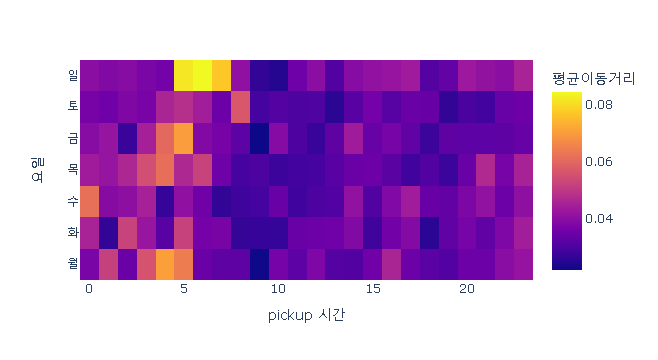

In [27]:
fig = px.density_heatmap(
    data_frame = tidydata,
    x = 'pickup_hour',
    y = 'dayofweek',
    z = 'dist',
    nbinsx=24,
    nbinsy=7,
    height=300

)
fig.data[0]['hovertemplate'] = 'pickup_hour=%{x}<br>dayofweek=%{y}<br>sum of dist_mean=%{z}<extra></extra>'

layout = {'xaxis':{'title':'pickup 시간'},
          'yaxis':{'title':'요일'},
          'coloraxis': {'colorbar': {'title': {'text': '평균이동거리'}}}

}
fig2 = fig.update_layout(layout)
fig2.show()

## `(3)` 속력별 경로시각화 -- 50점

In [28]:
# 데이터 전처리(pickup, dropoff df 추출 함수만들고 -> groupby id 별로 )
pcol = ['pickup_datetime', 'pickup_longitude', 'pickup_latitude', 'pickup_hour']
dcol = ['dropoff_datetime', 'dropoff_longitude', 'dropoff_latitude', 'dropoff_hour']
def transform(df):
    pickup = df.loc[:,['id']+pcol].set_axis(['id', 'datetime', 'longitude', 'latitude', 'hour'],axis=1).assign(type = 'pickup')
    dropoff = df.loc[:,['id']+dcol].set_axis(['id', 'datetime', 'longitude', 'latitude', 'hour'],axis=1).assign(type = 'dropoff')
    return pd.concat([pickup,dropoff],axis=0)

df_left = df_small.drop(pcol+dcol,axis=1)
df_right = pd.concat([transform(df) for i, df in df_small.groupby('id')]).reset_index(drop=True)
df_small2 = df_left.merge(df_right)
df_small2 = df_small2.sort_values('speed')

In [29]:
# tidydata
tidydata = df_small2.assign(speed_cut = pd.qcut(df_small2.speed,4,labels = ['매우느림','조금느림','조금빠름','매우빠름']))
tidydata

,id,vendor_id,passenger_count,store_and_fwd_flag,trip_duration,log_trip_duration,dist,speed,dayofweek,datetime,longitude,latitude,hour,type,speed_cut
95,id1891478,B,2,N,398,5.986452,0.000000,0.000000e+00,0,2016-05-30 11:45:05,-73.970901,40.759830,11,dropoff,매우느림
94,id1891478,B,2,N,398,5.986452,0.000000,0.000000e+00,0,2016-05-30 11:38:27,-73.970901,40.759830,11,pickup,매우느림
38,id1395947,A,1,N,2192,7.692570,0.000391,1.785380e-07,5,2016-03-19 16:46:57,-73.981133,40.781685,16,pickup,매우느림
39,id1395947,A,1,N,2192,7.692570,0.000391,1.785380e-07,5,2016-03-19 17:23:29,-73.981201,40.781300,17,dropoff,매우느림
110,id0616736,B,2,N,884,6.784457,0.002722,3.078877e-06,1,2016-01-19 10:20:07,-73.969322,40.763519,10,pickup,매우느림
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,id3646444,A,1,N,2057,7.629004,0.210542,1.023540e-04,1,2016-05-24 01:22:51,-73.952194,40.781292,1,dropoff,매우빠름
218,id0345371,B,2,N,1630,7.396335,0.170436,1.045620e-04,6,2016-03-20 06:42:25,-73.781967,40.644691,6,pickup,매우빠름
219,id0345371,B,2,N,1630,7.396335,0.170436,1.045620e-04,6,2016-03-20 07:09:35,-73.939919,40.708721,7,dropoff,매우빠름
139,id2676557,A,1,N,97,4.574711,0.010579,1.090595e-04,2,2016-02-03 07:23:09,-73.978119,40.748184,7,dropoff,매우빠름


/root/anaconda3/envs/dv2023/lib/python3.10/site-packages/plotly/express/_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/root/anaconda3/envs/dv2023/lib/python3.10/site-packages/plotly/express/_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



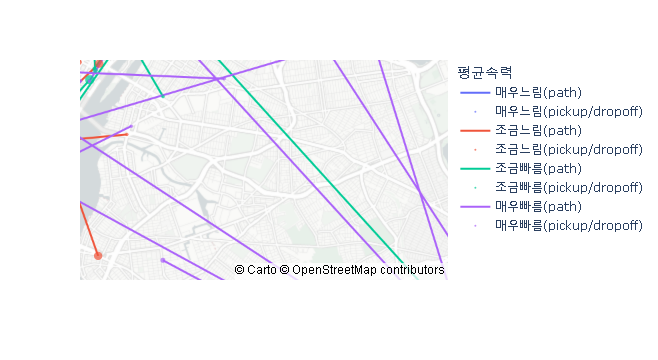

In [30]:
#| title: 속력별 경로시각화
fig = px.line_mapbox(
    data_frame=tidydata,
    lat = 'latitude',
    lon = 'longitude',
    color = 'speed_cut',
    line_group = 'id',
    center = {'lat':40.7322, 'lon':-73.9052},
    #---#
    mapbox_style = 'carto-positron',
    zoom = 11
)
scatter_data = px.scatter_mapbox(
    data_frame=tidydata,
    lat = 'latitude',
    lon = 'longitude',
    size = 'passenger_count',
    size_max = 7,
    color = 'speed_cut',
    #---#
    mapbox_style = 'carto-positron',
    zoom = 11
).data

for sd in scatter_data:
    fig.add_trace(sd)

for i in fig.data:
  if i['mode'] == 'lines':
    i['name'] = i['name'] + '(path)'
  else:
    i['name'] = i['name'] + '(pickup/dropoff)'

layout = {'legend': {'title': {'text': '평균속력'}}}
fig3 = fig.update_layout(layout)

fig3.show(config={'scrollZoom':False})

# 2. 에너지사용량 (지리정보시각화) -- 50점

### 데이터

In [31]:
# 데이터 불러오기
global_dict = json.loads(requests.get('https://raw.githubusercontent.com/southkorea/southkorea-maps/master/kostat/2018/json/skorea-provinces-2018-geo.json').text)
local_dict = json.loads(requests.get('https://raw.githubusercontent.com/southkorea/southkorea-maps/master/kostat/2018/json/skorea-municipalities-2018-geo.json').text)
#--#
url = 'https://raw.githubusercontent.com/guebin/DV2022/main/posts/Energy/{}.csv'
prov = ['Seoul', 'Busan', 'Daegu', 'Incheon',
        'Gwangju', 'Daejeon', 'Ulsan', 'Sejongsi',
        'Gyeonggi-do', 'Gangwon-do', 'Chungcheongbuk-do',
        'Chungcheongnam-do', 'Jeollabuk-do', 'Jeollanam-do',
        'Gyeongsangbuk-do', 'Gyeongsangnam-do', 'Jeju-do']
df = pd.concat([pd.read_csv(url.format(p+y)).assign(년도=y, 시도=p) for p in prov for y in ['2018', '2019', '2020', '2021']]).reset_index(drop=True)\
.assign(년도 = lambda df: df.년도.astype(int))\
.set_index(['년도','시도','지역']).applymap(lambda x: int(str(x).replace(',','')))\
.reset_index()
df.head()

/tmp/ipykernel_2028/3328129964.py:13: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



,년도,시도,지역,건물동수,연면적,에너지사용량(TOE)/전기,에너지사용량(TOE)/도시가스,에너지사용량(TOE)/지역난방
0,2018,Seoul,종로구,17929,9141777,64818,82015,111
1,2018,Seoul,중구,10598,10056233,81672,75260,563
2,2018,Seoul,용산구,17201,10639652,52659,85220,12043
3,2018,Seoul,성동구,14180,11631770,60559,107416,0
4,2018,Seoul,광진구,21520,12054796,70609,130308,0


In [32]:
# 데이터 정리
df_global = pd.DataFrame([l['properties'] for l in global_dict['features']])
df_local = pd.DataFrame([l['properties'] for l in local_dict['features']])


In [35]:
# _dct : 전주시완산구 -> 전주시-완산구 
_dct = dict()
for name in df_local['name']:
    if ('시' in name) and ('구' in name) and (len(name)>3):
      a,b = name.split('시')
      _dct[name] = a+'시'+'-'+b

# dict 파일 연결
df_json = df_local.assign(local_changed = df_local.name).set_index('local_changed').rename(_dct).reset_index()\
.set_index('name')\
.rename(
    {name:name.split('시')[-1] for name in df_local['name'] if ('시' in name) and ('구' in name) and (len(name)>3)}
).reset_index()\
.drop(['base_year','name_eng'],axis=1)\
.rename({'name':'name_local','code':'code_local'},axis=1)\
.assign(code = lambda df: df['code_local'].str[:2])\
.merge(df_global.drop(['base_year','name_eng'],axis=1))
df_json

# df_left, df_right
df_left = df.assign(
    시도 = lambda df: df.시도.map({l['properties']['name_eng']:l['properties']['name'] for l in global_dict['features']})
).assign(on = lambda df: df.시도 + '-' + df.지역)

df_right = df_json.assign(on = lambda df: df.name + '-' + df.name_local)\
.drop(['name_local','name'],axis=1)

df2 = df_left.merge(
    df_right.set_index('on')\
    .rename({'인천광역시-남구':'인천광역시-미추홀구'})\
    .reset_index()
).drop(['on'],axis=1)
df2

,년도,시도,지역,건물동수,연면적,에너지사용량(TOE)/전기,에너지사용량(TOE)/도시가스,에너지사용량(TOE)/지역난방,local_changed,code_local,code
0,2018,서울특별시,종로구,17929,9141777,64818,82015,111,종로구,11010,11
1,2019,서울특별시,종로구,17851,9204140,63492,76653,799,종로구,11010,11
2,2020,서울특별시,종로구,17638,9148895,60123,71263,912,종로구,11010,11
3,2021,서울특별시,종로구,22845,18551145,125179,117061,0,종로구,11010,11
4,2018,서울특별시,중구,10598,10056233,81672,75260,563,중구,11020,11
...,...,...,...,...,...,...,...,...,...,...,...
995,2021,제주특별자치도,제주시,67053,20275738,103217,25689,0,제주시,39010,39
996,2018,제주특별자치도,서귀포시,34154,6914685,34470,1597,0,서귀포시,39020,39
997,2019,제주특별자치도,서귀포시,34729,7233931,34641,1306,0,서귀포시,39020,39
998,2020,제주특별자치도,서귀포시,34880,7330040,35510,1639,0,서귀포시,39020,39


## (1) 에너지사용량차이(전기-도시가스) 시각화 – 25점

In [36]:
# tidydata
tidydata = df2.assign(a = df2.시도 + '/' + df2.local_changed).set_index('a').rename({'인천광역시/남구' : '인천광역시/미추홀구'}, axis = 0).reset_index().assign(지역 = lambda _df : _df.a.str.split('/').str[1])\
.drop(['a','local_changed'], axis = 1).assign(에너지사용량차이 =(lambda _df : _df['에너지사용량(TOE)/전기'] - _df['에너지사용량(TOE)/도시가스']) ).rename({'에너지사용량차이':'에너지사용량차이(전기-도시가스)'},axis = 1)
tidydata

,년도,시도,지역,건물동수,연면적,에너지사용량(TOE)/전기,에너지사용량(TOE)/도시가스,에너지사용량(TOE)/지역난방,code_local,code,에너지사용량차이(전기-도시가스)
0,2018,서울특별시,종로구,17929,9141777,64818,82015,111,11010,11,-17197
1,2019,서울특별시,종로구,17851,9204140,63492,76653,799,11010,11,-13161
2,2020,서울특별시,종로구,17638,9148895,60123,71263,912,11010,11,-11140
3,2021,서울특별시,종로구,22845,18551145,125179,117061,0,11010,11,8118
4,2018,서울특별시,중구,10598,10056233,81672,75260,563,11020,11,6412
...,...,...,...,...,...,...,...,...,...,...,...
995,2021,제주특별자치도,제주시,67053,20275738,103217,25689,0,39010,39,77528
996,2018,제주특별자치도,서귀포시,34154,6914685,34470,1597,0,39020,39,32873
997,2019,제주특별자치도,서귀포시,34729,7233931,34641,1306,0,39020,39,33335
998,2020,제주특별자치도,서귀포시,34880,7330040,35510,1639,0,39020,39,33871


In [41]:
# dict 정리
_lst = tidydata.query("시도=='서울특별시' or 시도 == '경기도' or 시도 == '인천광역시' ")['code'].unique()

sudo_dict = local_dict.copy()
sudo_dict['features'] = [l for l in sudo_dict['features'] if l['properties']['code'][:2] in _lst]


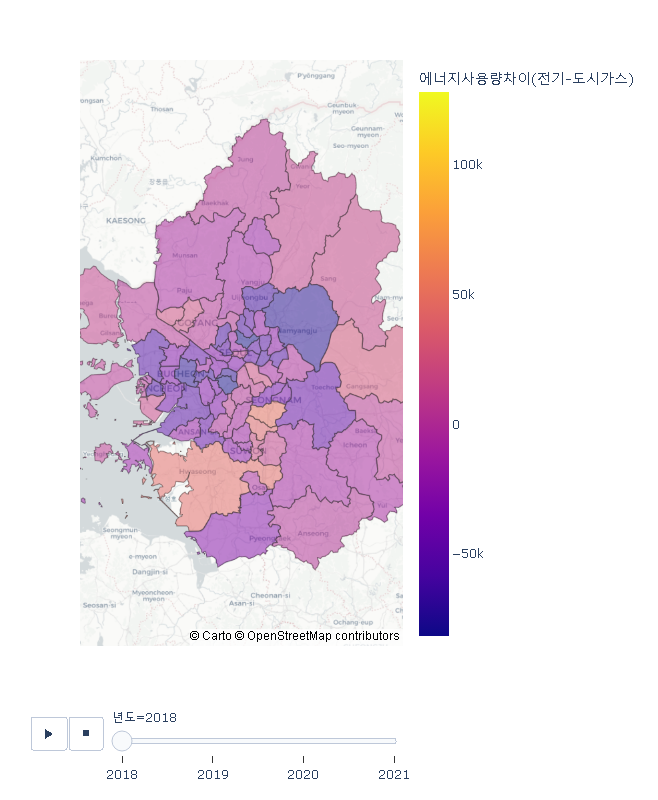

In [42]:
fig4 = px.choropleth_mapbox(
    geojson = sudo_dict,
    featureidkey = 'properties.code',
    data_frame = tidydata,
    locations = 'code_local',
    color = '에너지사용량차이(전기-도시가스)',
    animation_frame= '년도',
    hover_data = ['시도','지역'],
    #---#
    mapbox_style="carto-positron",
    range_color = [min(tidydata['에너지사용량차이(전기-도시가스)']),max(tidydata['에너지사용량차이(전기-도시가스)'])],
    center={"lat": 37.5642135, "lon": 127.0016985},
    opacity = 0.5,
    zoom=7.5,
    height=800,
    width=750
)
fig4.show(config={'scrollZoom':False})


## 문제2 (서울+김포)특별시? 

In [43]:
df3 = df2.assign(a = df2.시도 + '/' + df2.local_changed).set_index('a').rename({'인천광역시/남구' : '인천광역시/미추홀구'}, axis = 0).reset_index().assign(지역 = lambda _df : _df.a.str.split('/').str[1])\
.drop(['a','local_changed'], axis = 1)
df3

,년도,시도,지역,건물동수,연면적,에너지사용량(TOE)/전기,에너지사용량(TOE)/도시가스,에너지사용량(TOE)/지역난방,code_local,code
0,2018,서울특별시,종로구,17929,9141777,64818,82015,111,11010,11
1,2019,서울특별시,종로구,17851,9204140,63492,76653,799,11010,11
2,2020,서울특별시,종로구,17638,9148895,60123,71263,912,11010,11
3,2021,서울특별시,종로구,22845,18551145,125179,117061,0,11010,11
4,2018,서울특별시,중구,10598,10056233,81672,75260,563,11020,11
...,...,...,...,...,...,...,...,...,...,...
995,2021,제주특별자치도,제주시,67053,20275738,103217,25689,0,39010,39
996,2018,제주특별자치도,서귀포시,34154,6914685,34470,1597,0,39020,39
997,2019,제주특별자치도,서귀포시,34729,7233931,34641,1306,0,39020,39
998,2020,제주특별자치도,서귀포시,34880,7330040,35510,1639,0,39020,39


In [44]:
sol2_right = df3.query("지역 == '김포시' or 시도 == '서울특별시'")\
.pivot_table(index = '년도', values = ['에너지사용량(TOE)/전기','에너지사용량(TOE)/도시가스','에너지사용량(TOE)/지역난방'],aggfunc = 'sum').assign(에너지사용량 = lambda _df : _df['에너지사용량(TOE)/전기']+_df['에너지사용량(TOE)/도시가스'] + _df['에너지사용량(TOE)/지역난방']).reset_index()\
.drop(['에너지사용량(TOE)/전기','에너지사용량(TOE)/도시가스','에너지사용량(TOE)/지역난방'],axis = 1)

sol2_right

,년도,에너지사용량
0,2018,5600005
1,2019,5361143
2,2020,5302924
3,2021,7857412


In [45]:
sol2_left = df3.query("지역 == '김포시' or 시도 == '서울특별시'")
sol2_left

,년도,시도,지역,건물동수,연면적,에너지사용량(TOE)/전기,에너지사용량(TOE)/도시가스,에너지사용량(TOE)/지역난방,code_local,code
0,2018,서울특별시,종로구,17929,9141777,64818,82015,111,11010,11
1,2019,서울특별시,종로구,17851,9204140,63492,76653,799,11010,11
2,2020,서울특별시,종로구,17638,9148895,60123,71263,912,11010,11
3,2021,서울특별시,종로구,22845,18551145,125179,117061,0,11010,11
4,2018,서울특별시,중구,10598,10056233,81672,75260,563,11020,11
...,...,...,...,...,...,...,...,...,...,...
99,2021,서울특별시,강동구,18715,24990185,110313,144513,16676,11250,11
432,2018,경기도,김포시,15415,16499016,75482,72267,38969,31230,31
433,2019,경기도,김포시,16038,17063243,76800,72793,38566,31230,31
434,2020,경기도,김포시,16243,17534638,78417,75329,39953,31230,31


In [46]:
tidydata = sol2_left.merge(sol2_right).assign(에너지사용비율 = lambda _df : (_df['에너지사용량(TOE)/전기']+_df['에너지사용량(TOE)/도시가스']+_df['에너지사용량(TOE)/지역난방'])/_df['에너지사용량'])
tidydata

,년도,시도,지역,건물동수,연면적,에너지사용량(TOE)/전기,에너지사용량(TOE)/도시가스,에너지사용량(TOE)/지역난방,code_local,code,에너지사용량,에너지사용비율
0,2018,서울특별시,종로구,17929,9141777,64818,82015,111,11010,11,5600005,0.026240
1,2018,서울특별시,중구,10598,10056233,81672,75260,563,11020,11,5600005,0.028124
2,2018,서울특별시,용산구,17201,10639652,52659,85220,12043,11030,11,5600005,0.026772
3,2018,서울특별시,성동구,14180,11631770,60559,107416,0,11040,11,5600005,0.029996
4,2018,서울특별시,광진구,21520,12054796,70609,130308,0,11050,11,5600005,0.035878
...,...,...,...,...,...,...,...,...,...,...,...,...
99,2021,서울특별시,서초구,16686,32824535,242700,181974,39854,11220,11,7857412,0.059120
100,2021,서울특별시,강남구,22464,48871036,364645,236446,95742,11230,11,7857412,0.088685
101,2021,서울특별시,송파구,22727,38819901,236444,185492,94175,11240,11,7857412,0.065685
102,2021,서울특별시,강동구,18715,24990185,110313,144513,16676,11250,11,7857412,0.034554


### dict 정리

In [47]:
_lst = tidydata.query("시도=='서울특별시' or 지역 == '김포시' ")['code_local'].unique()
_lst
new_seoul_dict = local_dict.copy()
new_seoul_dict['features'] = [l for l in new_seoul_dict['features'] if l['properties']['code'] in _lst]

### figure 그리기

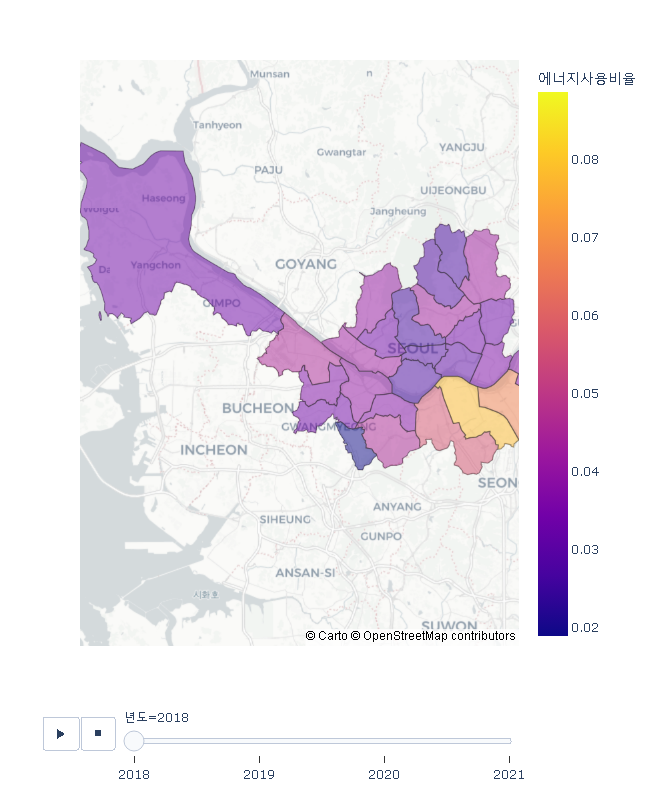

In [48]:
fig5 = px.choropleth_mapbox(
    geojson = new_seoul_dict,
    featureidkey = 'properties.code',
    data_frame = tidydata,
    locations = 'code_local',
    color = '에너지사용비율',
    animation_frame= '년도',
    hover_data = ['시도','지역'],
    #---#
    mapbox_style="carto-positron",
    range_color = [min(tidydata['에너지사용비율']),max(tidydata['에너지사용비율'])],
    center={"lat":  37.5612, "lon": 126.8228},
    opacity = 0.5,
    zoom= 9,
    height=800,
    width=750
)
fig5.show(config={'scrollZoom':False})
